In [ ]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.tokenize import sent_tokenize, word_tokenize 
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer 
from nltk.corpus import wordnet
from nltk.tag import pos_tag
import os
import io
# import some common libraries
import numpy as np
import cv2
import torch
import pandas as pd
# Show the image in ipynb
from IPython.display import clear_output, Image, display
import PIL.Image
import ast
import stanza 
import spacy_stanza
#for plotting images & adjusting colors
import matplotlib.pyplot as plt
import matplotlib as mpl
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image
import string


In [ ]:
dataset = pd.read_csv('../data/datasets/cap_csv/caps_train_1902.csv', sep='\t')
dataset.drop(['Unnamed: 0'], axis=1, inplace=True)
dataset

,file_name,misogynous,caption
0,1.jpg,0,a white pitcher and a piece of cheese on a table.
1,10.jpg,1,a panda bear sitting on a stump with a bottle.
2,1000.jpg,0,a man and a woman sitting on a bed playing a v...
3,10000.jpg,0,a man jumping in the air with a cell phone.
4,10006.jpg,0,a picture of a house with a cat and a pumpkin.
...,...,...,...
9995,15002.jpg,0,a lion sitting in the grass in a field.
9996,15003.jpg,0,a woman is standing in an office building.
9997,15004.jpg,0,a little girl in a dress standing in a street.
9998,15005.jpg,0,a kitchen with a pan on top of a stove.


In [ ]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.tokenize import sent_tokenize, word_tokenize 
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer 
from nltk.corpus import wordnet
from nltk.tag import pos_tag

[nltk_data] Downloading package punkt to /home/jimmy/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /home/jimmy/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/jimmy/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /home/jimmy/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [ ]:
def apply_lemmatization_stanza(texts):
    """ Apply lemmatizaion with post tagging operatio through Stanza.
    Remove stopwords and puntuation.
    Lower case """
    stanza.download("en")
    nlp = spacy_stanza.load_pipeline("en")
    processed_text = []
    
    for testo in texts:
        rev = []
        caps = testo.translate(str.maketrans('', '', string.punctuation))
        #testo = testo.lower()
        #testo = re.sub(r'\d+', '', testo)  # remove numbers
        #testo = re.sub('[^A-Za-z0-9 ]+', '', testo)  # remove special character
        #testo = " ".join(testo.split())  # single_spaces

        doc = nlp(caps)
        for token in doc:
            rev.append(token.lemma_)
            # print(token.lemma_)

        #for word in list(rev):  # iterating on a copy since removing will mess things up
        #    if word in stopwords:
        #        rev.remove(word)

        rev = str(rev).replace("'", '').replace(",", '').replace("[", '').replace("]", '').replace("\"", '')
        processed_text.append(rev)
    return (processed_text)

In [ ]:
#res syn have meme in the seme order od dataset
dataset['clean']= apply_lemmatization_stanza(dataset['caption'])

2022-03-14 00:52:50 INFO: Downloading default packages for language: en (English)...
2022-03-14 00:52:51 INFO: File exists: /home/jimmy/stanza_resources/en/default.zip.
2022-03-14 00:52:55 INFO: Finished downloading models and saved to /home/jimmy/stanza_resources.
2022-03-14 00:52:55 INFO: Loading these models for language: en (English):
| Processor    | Package   |
----------------------------
| tokenize     | combined  |
| pos          | combined  |
| lemma        | combined  |
| depparse     | combined  |
| sentiment    | sstplus   |
| constituency | wsj       |
| ner          | ontonotes |

2022-03-14 00:52:55 INFO: Use device: gpu
2022-03-14 00:52:55 INFO: Loading: tokenize
2022-03-14 00:52:57 INFO: Loading: pos
2022-03-14 00:52:57 INFO: Loading: lemma
2022-03-14 00:52:57 INFO: Loading: depparse
2022-03-14 00:52:58 INFO: Loading: sentiment
2022-03-14 00:52:58 INFO: Loading: constituency
2022-03-14 00:52:59 INFO: Loading: ner
2022-03-14 00:52:59 INFO: Done loading processors!


In [ ]:

dataset['clean']=  dataset['caption'].apply(lambda x: apply_lemmatization_stanza(x))

2022-02-23 22:09:05 INFO: Downloading default packages for language: en (English)...
2022-02-23 22:09:06 INFO: File exists: /home/jimmy/stanza_resources/en/default.zip.
2022-02-23 22:09:10 INFO: Finished downloading models and saved to /home/jimmy/stanza_resources.
2022-02-23 22:09:10 INFO: Loading these models for language: en (English):
| Processor    | Package   |
----------------------------
| tokenize     | combined  |
| pos          | combined  |
| lemma        | combined  |
| depparse     | combined  |
| sentiment    | sstplus   |
| constituency | wsj       |
| ner          | ontonotes |

2022-02-23 22:09:10 INFO: Use device: gpu
2022-02-23 22:09:10 INFO: Loading: tokenize
2022-02-23 22:09:13 INFO: Loading: pos
2022-02-23 22:09:13 INFO: Loading: lemma
2022-02-23 22:09:13 INFO: Loading: depparse
2022-02-23 22:09:14 INFO: Loading: sentiment
2022-02-23 22:09:14 INFO: Loading: constituency
2022-02-23 22:09:15 INFO: Loading: ner
2022-02-23 22:09:15 INFO: Done loading processors!
2022

RuntimeError: CUDA out of memory. Tried to allocate 116.00 MiB (GPU 0; 3.82 GiB total capacity; 2.05 GiB already allocated; 113.88 MiB free; 2.07 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [ ]:
# Data pre-processing
import string
import re
def data_pre_processing(data):
  #caps = re.sub(r'[\S]+\.(net|com|org|info|edu|gov|uk|de|ca|jp|fr|au|us|ru|ch|it|nel|se|no|es|mil)[\S]*\s?','',data)
  #caps = re.sub("@[^\s]+", '', data) #tag username
  #caps = NormalizeWithPOS(data)
  caps = data.translate(str.maketrans('', '', string.punctuation))
  #caps = re.sub(r'\d+', '', caps)
  #caps = caps.lower()
  #caps = caps.split()
  #caps = [word for word in caps if not word in stopwords]
  #caps = ' '.join(caps)

  return caps

dataset['clean']=  dataset['clean'].apply(lambda x: data_pre_processing(x))

In [ ]:
dataset.iloc[:,2:]

,caption,clean
0,a white pitcher and a piece of cheese on a table.,a white pitcher and a piece of cheese on a table
1,a panda bear sitting on a stump with a bottle.,a panda bear sit on a stump with a bottle
2,a man and a woman sitting on a bed playing a v...,a man and a woman sit on a bed play a video game
3,a man jumping in the air with a cell phone.,a man jump in the air with a cell phone
4,a picture of a house with a cat and a pumpkin.,a picture of a house with a cat and a pumpkin
...,...,...
9995,a lion sitting in the grass in a field.,a lion sit in the grass in a field
9996,a woman is standing in an office building.,a woman be stand in a office building
9997,a little girl in a dress standing in a street.,a little girl in a dress stand in a street
9998,a kitchen with a pan on top of a stove.,a kitchen with a pan on top of a stove


In [ ]:
dataset.to_csv("../data/datasets/cap_csv/caps_train_lemma2302.csv", sep="\t")

In [ ]:
dataset= pd.read_csv("../data/datasets/cap_csv/caps_train_lemma2302.csv", sep="\t")
dataset

,Unnamed: 0,file_name,misogynous,caption,clean
0,0,1.jpg,0,a white pitcher and a piece of cheese on a table.,a white pitcher and a piece of cheese on a table
1,1,10.jpg,1,a panda bear sitting on a stump with a bottle.,a panda bear sit on a stump with a bottle
2,2,1000.jpg,0,a man and a woman sitting on a bed playing a v...,a man and a woman sit on a bed play a video game
3,3,10000.jpg,0,a man jumping in the air with a cell phone.,a man jump in the air with a cell phone
4,4,10006.jpg,0,a picture of a house with a cat and a pumpkin.,a picture of a house with a cat and a pumpkin
...,...,...,...,...,...
9995,9995,15002.jpg,0,a lion sitting in the grass in a field.,a lion sit in the grass in a field
9996,9996,15003.jpg,0,a woman is standing in an office building.,a woman be stand in a office building
9997,9997,15004.jpg,0,a little girl in a dress standing in a street.,a little girl in a dress stand in a street
9998,9998,15005.jpg,0,a kitchen with a pan on top of a stove.,a kitchen with a pan on top of a stove


In [ ]:
dataset.rename({'clean': 'clean_caps'}, axis=1 ,inplace = True)

In [ ]:
dataset

,Unnamed: 0,file_name,misogynous,caption,clean_caps
0,0,1.jpg,0,a white pitcher and a piece of cheese on a table.,a white pitcher and a piece of cheese on a table
1,1,10.jpg,1,a panda bear sitting on a stump with a bottle.,a panda bear sit on a stump with a bottle
2,2,1000.jpg,0,a man and a woman sitting on a bed playing a v...,a man and a woman sit on a bed play a video game
3,3,10000.jpg,0,a man jumping in the air with a cell phone.,a man jump in the air with a cell phone
4,4,10006.jpg,0,a picture of a house with a cat and a pumpkin.,a picture of a house with a cat and a pumpkin
...,...,...,...,...,...
9995,9995,15002.jpg,0,a lion sitting in the grass in a field.,a lion sit in the grass in a field
9996,9996,15003.jpg,0,a woman is standing in an office building.,a woman be stand in a office building
9997,9997,15004.jpg,0,a little girl in a dress standing in a street.,a little girl in a dress stand in a street
9998,9998,15005.jpg,0,a kitchen with a pan on top of a stove.,a kitchen with a pan on top of a stove


In [ ]:
captions = list(dataset["clean_caps"])

In [ ]:
for token in captions[0].split():
    print(token)


a
white
pitcher
and
a
piece
of
cheese
on
a
table


In [ ]:
token_corpus = []
for doc in captions:
    tokens = doc.split()
    for token in tokens:
        token_corpus.append(token)

In [ ]:
len(token_corpus)

99061

In [ ]:
unique = set(token_corpus)
len(unique)

1163

In [ ]:
from collections import Counter
cnt_tot = Counter()

for item in token_corpus:
    cnt_tot[item] += 1

termini = cnt_tot.most_common(383)


In [ ]:
import ast
terms_mis = []
terms_not_mis = []
terms = []
for i in range(0, len(dataset)):
    elem = []
    if dataset["misogynous"][i] == 1:
        elem_mis = []
        for token in dataset["clean_caps"][i].split():
                elem_mis.append(token)
                elem.append(token)
        terms_mis.append(elem_mis)
        terms.append(elem)
    if dataset["misogynous"][i] == 0:
        elem_notmis=[]
        for token in dataset["clean_caps"][i].split():
            elem_notmis.append(token)
            elem.append(token)
            
        terms_not_mis.append(elem_notmis)
        terms.append(elem)

In [ ]:
print(len(terms))
print(len(terms_mis))
print(len(terms_not_mis))

10000
5000
5000


In [ ]:
from collections import Counter
cnt_tot = Counter()
for item in terms:
    for token in item:
        cnt_tot[token] += 1
cnt_tot.most_common()

[('a', 24997),
 ('of', 8350),
 ('in', 4029),
 ('picture', 3600),
 ('woman', 3463),
 ('man', 3412),
 ('on', 3111),
 ('with', 3099),
 ('and', 2453),
 ('stand', 1882),
 ('be', 1804),
 ('sit', 1480),
 ('the', 1173),
 ('hold', 1066),
 ('front', 1019),
 ('group', 950),
 ('to', 831),
 ('people', 778),
 ('next', 677),
 ('person', 665),
 ('couple', 594),
 ('she', 553),
 ('table', 539),
 ('face', 528),
 ('cat', 408),
 ('sign', 404),
 ('top', 398),
 ('other', 398),
 ('at', 396),
 ('each', 390),
 ('phone', 383),
 ('wear', 377),
 ('up', 359),
 ('suit', 353),
 ('he', 349),
 ('car', 327),
 ('tie', 326),
 ('it', 322),
 ('poster', 318),
 ('white', 314),
 ('two', 310),
 ('lay', 296),
 ('red', 283),
 ('black', 282),
 ('collage', 281),
 ('hand', 281),
 ('cell', 276),
 ('dog', 270),
 ('room', 267),
 ('smile', 262),
 ('bed', 246),
 ('girl', 232),
 ('hat', 231),
 ('glasses', 227),
 ('joke', 220),
 ('shirt', 217),
 ('close', 216),
 ('bikini', 214),
 ('talk', 209),
 ('hair', 205),
 ('screen', 198),
 ('cartoon'

In [ ]:
from collections import Counter
cnt_mis = Counter()
for item in terms_mis:
    for token in item:
        cnt_mis[token] += 1
cnt_mis.most_common()

[('a', 12392),
 ('of', 3691),
 ('woman', 2676),
 ('in', 2216),
 ('picture', 1593),
 ('on', 1559),
 ('with', 1506),
 ('man', 1416),
 ('and', 1154),
 ('be', 1033),
 ('stand', 1004),
 ('sit', 755),
 ('the', 633),
 ('hold', 572),
 ('front', 528),
 ('she', 459),
 ('to', 458),
 ('group', 399),
 ('next', 361),
 ('people', 332),
 ('face', 277),
 ('couple', 270),
 ('person', 249),
 ('phone', 228),
 ('table', 222),
 ('top', 219),
 ('other', 215),
 ('each', 212),
 ('bikini', 209),
 ('sign', 204),
 ('car', 195),
 ('at', 191),
 ('lay', 180),
 ('cell', 173),
 ('wear', 171),
 ('up', 169),
 ('poster', 165),
 ('smile', 164),
 ('two', 164),
 ('hand', 162),
 ('hair', 153),
 ('suit', 151),
 ('room', 146),
 ('red', 145),
 ('white', 143),
 ('he', 139),
 ('talk', 137),
 ('bed', 136),
 ('girl', 136),
 ('glasses', 129),
 ('tie', 128),
 ('black', 127),
 ('it', 121),
 ('magazine', 119),
 ('dress', 118),
 ('collage', 115),
 ('kitchen', 113),
 ('shirt', 112),
 ('joke', 110),
 ('hat', 104),
 ('close', 102),
 ('cat'

In [ ]:
ignore = ['a','in','it','of', 'and', 'on', 'the', 'to', 'with', 'on', 'picture']

for word in list(cnt_mis):
    if word in ignore:
        del cnt_mis[word]

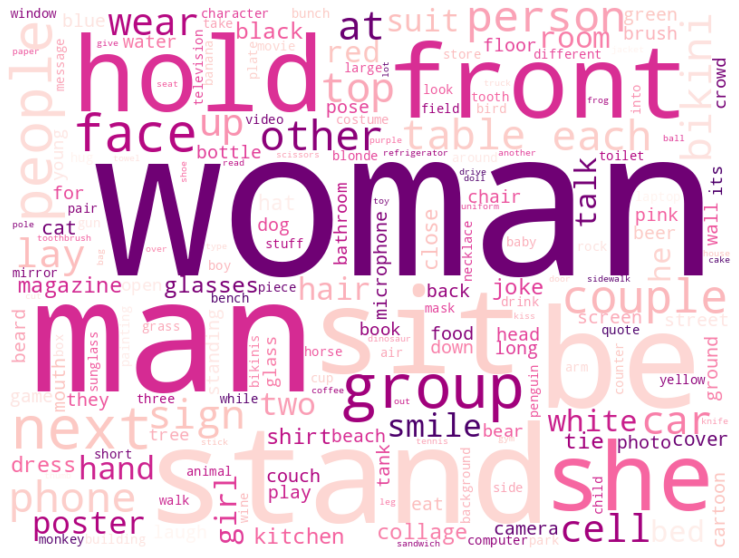

In [ ]:
# create the WordCloud object
wordcloud = WordCloud(width = 800, height= 600,min_word_length =3,
                      background_color='white', colormap='RdPu')

# generate the word cloud
wordcloud.generate_from_frequencies(cnt_mis)

plt.figure( figsize=(20,10) )
#plot
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.savefig("identitycaps.jpg")
plt.show()

In [ ]:
from collections import Counter
cnt_notmis = Counter()
for item in terms_not_mis:
    for token in item:
        cnt_notmis[token] += 1
cnt_notmis.most_common()

[('a', 12605),
 ('of', 4659),
 ('picture', 2007),
 ('man', 1996),
 ('in', 1813),
 ('with', 1593),
 ('on', 1552),
 ('and', 1299),
 ('stand', 878),
 ('woman', 787),
 ('be', 771),
 ('sit', 725),
 ('group', 551),
 ('the', 540),
 ('hold', 494),
 ('front', 491),
 ('people', 446),
 ('person', 416),
 ('to', 373),
 ('couple', 324),
 ('table', 317),
 ('next', 316),
 ('cat', 314),
 ('face', 251),
 ('he', 210),
 ('wear', 206),
 ('at', 205),
 ('suit', 202),
 ('it', 201),
 ('sign', 200),
 ('tie', 198),
 ('dog', 191),
 ('up', 190),
 ('other', 183),
 ('top', 179),
 ('each', 178),
 ('white', 171),
 ('collage', 166),
 ('phone', 155),
 ('black', 155),
 ('poster', 153),
 ('two', 146),
 ('penguin', 140),
 ('screen', 139),
 ('cartoon', 138),
 ('red', 138),
 ('car', 132),
 ('hat', 127),
 ('room', 121),
 ('hand', 119),
 ('bear', 116),
 ('lay', 116),
 ('close', 114),
 ('bed', 110),
 ('joke', 110),
 ('different', 105),
 ('shirt', 105),
 ('cell', 103),
 ('game', 100),
 ('green', 99),
 ('glasses', 98),
 ('smile',

In [ ]:
ignore = ['a','in','it','of', 'and', 'on', 'the', 'to', 'with', 'on', 'picture']

for word in list(cnt_notmis):
    if word in ignore:
        del cnt_notmis[word]

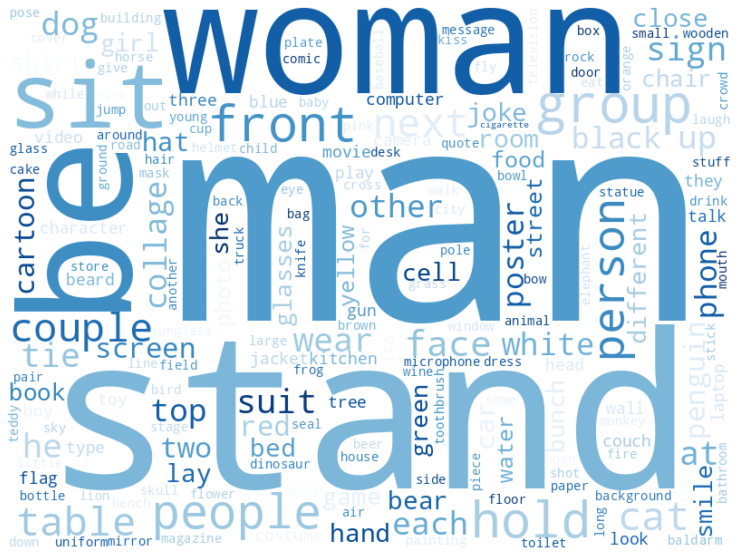

In [ ]:
# create the WordCloud object
wordcloud = WordCloud(width = 800, height= 600,min_word_length =3,
                      background_color='white', colormap="Blues")

# generate the word cloud
wordcloud.generate_from_frequencies(cnt_notmis)

plt.figure( figsize=(20,10) )
#plot
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.savefig("identitycaps_notmis.jpg")
plt.show()

In [ ]:
termini_mis = []
for item in termini:
    termini_mis.append((item[0], cnt_mis[item[0]]))

In [ ]:
perc_mis = []
for i in range(0,len(object_tags)):
    #print(item[0])
    print(tags_mis[i][0])
    perc = tags_mis[i][1]/(object_tags[i][1])
    perc_mis.append({"tag": tags_mis[i][0], "perc": perc})

Stump


TypeError: unsupported operand type(s) for /: 'str' and 'int'

In [ ]:
perc_mis = []
for i in range(0,len(termini)):
    #print(item[0])
    print(termini_mis[i][0])
    perc = termini_mis[i][1]/(termini[i][1])
    perc_mis.append({"tag": termini_mis[i][0], "perc": perc})

picture
woman
man
be
stand
sit
hold
front
group
people
next
person
couple
her
table
face
cat
sign
top
other
each
phone
wear
up
suit
his
car
tie
it
poster
white
glass
two
lay
red
black
collage
hand
cell
dog
room
men
bed
smile
bikini
girl
hat
joke
shirt
close
talk
hair
screen
cartoon
kitchen
penguin
chair
bear
green
magazine
game
food
dress
street
camera
couch
different
standing
water
blue
photo
book
cover
bunch
floor
mouth
wall
beard
head
microphone
yellow
computer
its
play
tree
bottle
laugh
beach
video
back
boy
character
their
gun
three
ground
costume
pink
for
movie
long
look
building
young
down
background
mask
animal
large
jacket
eat
laptop
toy
field
air
tank
crowd
around
house
bird
walk
pose
type
piece
baby
beer
flag
painting
pair
sunglass
rock
brush
message
grass
plate
bathroom
side
window
wine
child
quote
uniform
open
cup
paper
stuffed
monkey
toilet
television
box
store
knife
lion
bench
statue
park
drink
door
teeth
frog
dinosaur
pole
mirror
cake
horse
arm
brown
while
into
bald
truc

In [ ]:
termini_notmis = []
for item in termini:
    termini_notmis.append((item[0], cnt_notmis[item[0]]))

In [ ]:
perc_notmis = []
for i in range(0,len(termini)):
    #print(item[0])
    print(termini_notmis[i][0])
    perc = termini_notmis[i][1]/(termini[i][1])
    perc_notmis.append({"tag": termini_notmis[i][0], "perc": perc})

picture
woman
man
be
stand
sit
hold
front
group
people
next
person
couple
her
table
face
cat
sign
top
other
each
phone
wear
up
suit
his
car
tie
it
poster
white
glass
two
lay
red
black
collage
hand
cell
dog
room
men
bed
smile
bikini
girl
hat
joke
shirt
close
talk
hair
screen
cartoon
kitchen
penguin
chair
bear
green
magazine
game
food
dress
street
camera
couch
different
standing
water
blue
photo
book
cover
bunch
floor
mouth
wall
beard
head
microphone
yellow
computer
its
play
tree
bottle
laugh
beach
video
back
boy
character
their
gun
three
ground
costume
pink
for
movie
long
look
building
young
down
background
mask
animal
large
jacket
eat
laptop
toy
field
air
tank
crowd
around
house
bird
walk
pose
type
piece
baby
beer
flag
painting
pair
sunglass
rock
brush
message
grass
plate
bathroom
side
window
wine
child
quote
uniform
open
cup
paper
stuffed
monkey
toilet
television
box
store
knife
lion
bench
statue
park
drink
door
teeth
frog
dinosaur
pole
mirror
cake
horse
arm
brown
while
into
bald
truc

In [ ]:
perc_notmis

[{'tag': 'picture', 'perc': 0.5105555555555555},
 {'tag': 'woman', 'perc': 0.43470740847506484},
 {'tag': 'man', 'perc': 0.5204696921612186},
 {'tag': 'be', 'perc': 0.4883592017738359},
 {'tag': 'stand', 'perc': 0.4927616926503341},
 {'tag': 'sit', 'perc': 0.48846675712347354},
 {'tag': 'hold', 'perc': 0.49157303370786515},
 {'tag': 'front', 'perc': 0.5171736997055937},
 {'tag': 'group', 'perc': 0.49473684210526314},
 {'tag': 'people', 'perc': 0.5141388174807198},
 {'tag': 'next', 'perc': 0.48005908419497784},
 {'tag': 'person', 'perc': 0.5428571428571428},
 {'tag': 'couple', 'perc': 0.5084175084175084},
 {'tag': 'her', 'perc': 0.4358047016274864},
 {'tag': 'table', 'perc': 0.48794063079777367},
 {'tag': 'face', 'perc': 0.4753787878787879},
 {'tag': 'cat', 'perc': 0.5441176470588235},
 {'tag': 'sign', 'perc': 0.5099009900990099},
 {'tag': 'top', 'perc': 0.48743718592964824},
 {'tag': 'other', 'perc': 0.44974874371859297},
 {'tag': 'each', 'perc': 0.44871794871794873},
 {'tag': 'phone',

In [ ]:
difference = []
for i in range(0,len(perc_mis)):
    diff = perc_mis[i]["perc"] - perc_notmis[i]["perc"]
    difference.append({"tag": perc_mis[i]["tag"], "diff": diff})
difference

[{'tag': 'picture', 'diff': -0.02111111111111108},
 {'tag': 'woman', 'diff': 0.13058518304987032},
 {'tag': 'man', 'diff': -0.04093938432243727},
 {'tag': 'be', 'diff': 0.023281596452328135},
 {'tag': 'stand', 'diff': 0.014476614699331813},
 {'tag': 'sit', 'diff': 0.023066485753052923},
 {'tag': 'hold', 'diff': 0.01685393258426965},
 {'tag': 'front', 'diff': -0.03434739941118742},
 {'tag': 'group', 'diff': 0.010526315789473717},
 {'tag': 'people', 'diff': -0.028277634961439535},
 {'tag': 'next', 'diff': 0.03988183161004427},
 {'tag': 'person', 'diff': -0.08571428571428569},
 {'tag': 'couple', 'diff': -0.01683501683501687},
 {'tag': 'her', 'diff': 0.12839059674502717},
 {'tag': 'table', 'diff': 0.024118738404452722},
 {'tag': 'face', 'diff': 0.049242424242424254},
 {'tag': 'cat', 'diff': -0.08823529411764702},
 {'tag': 'sign', 'diff': -0.01980198019801982},
 {'tag': 'top', 'diff': 0.025125628140703515},
 {'tag': 'other', 'diff': 0.10050251256281406},
 {'tag': 'each', 'diff': 0.102564102

In [ ]:
from collections import Counter
diff_mis = Counter()
for item in difference[:30]:
    diff_mis[item["tag"]] += item["diff"]
diff_mis.most_common()

[('woman', 0.13058518304987032),
 ('her', 0.12839059674502717),
 ('each', 0.10256410256410259),
 ('other', 0.10050251256281406),
 ('face', 0.049242424242424254),
 ('next', 0.03988183161004427),
 ('top', 0.025125628140703515),
 ('table', 0.024118738404452722),
 ('be', 0.023281596452328135),
 ('sit', 0.023066485753052923),
 ('hold', 0.01685393258426965),
 ('car', 0.015290519877675823),
 ('stand', 0.014476614699331813),
 ('poster', 0.012578616352201255),
 ('group', 0.010526315789473717),
 ('phone', 0.007832898172323743),
 ('couple', -0.01683501683501687),
 ('sign', -0.01980198019801982),
 ('picture', -0.02111111111111108),
 ('people', -0.028277634961439535),
 ('up', -0.03064066852367686),
 ('front', -0.03434739941118742),
 ('his', -0.034883720930232565),
 ('man', -0.04093938432243727),
 ('suit', -0.04815864022662891),
 ('it', -0.05590062111801242),
 ('wear', -0.06199460916442051),
 ('person', -0.08571428571428569),
 ('cat', -0.08823529411764702),
 ('tie', -0.10429447852760737)]

<BarContainer object of 30 artists>

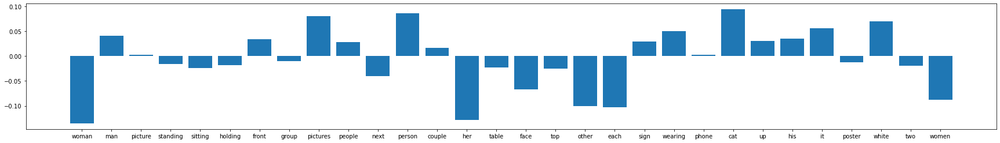

In [ ]:

import matplotlib.pyplot as plt

fig = plt.figure()
fig.set_figwidth(30)
plt.bar(diff_notmis.keys(), diff_notmis.values())

In [ ]:
difference.sort(key=lambda x: x["diff"], reverse=True)
table = pd.DataFrame(difference)
table[:30]

,tag,diff
0,pile,0.500000
1,blanket,0.444444
2,apple,0.428571
3,hug,0.405405
4,bat,0.400000
5,bar,0.375000
6,smoke,0.375000
7,ocean,0.363636
8,another,0.350000
9,wine,0.333333


In [ ]:
difference = []
for i in range(0,len(perc_notmis)):
    diff = perc_notmis[i]["perc"] - perc_mis[i]["perc"]
    difference.append({"tag": perc_notmis[i]["tag"], "diff": diff})
difference.sort(key=lambda x: x["diff"], reverse=True)
difference

[{'tag': 'shot', 'diff': 0.6363636363636365},
 {'tag': 'board', 'diff': 0.6000000000000001},
 {'tag': 'snow', 'diff': 0.4545454545454546},
 {'tag': 'eye', 'diff': 0.4545454545454546},
 {'tag': 'comic', 'diff': 0.375},
 {'tag': 'elephant', 'diff': 0.37142857142857144},
 {'tag': 'duck', 'diff': 0.368421052631579},
 {'tag': 'brick', 'diff': 0.368421052631579},
 {'tag': 'cut', 'diff': 0.3333333333333333},
 {'tag': 'sandwich', 'diff': 0.3333333333333333},
 {'tag': 'seal', 'diff': 0.3333333333333333},
 {'tag': 'rid', 'diff': 0.3333333333333333},
 {'tag': 'stove', 'diff': 0.3333333333333333},
 {'tag': 'screen', 'diff': 0.32323232323232326},
 {'tag': 'read', 'diff': 0.31034482758620685},
 {'tag': 'helmet', 'diff': 0.27777777777777773},
 {'tag': 'old', 'diff': 0.2631578947368421},
 {'tag': 'them', 'diff': 0.2631578947368421},
 {'tag': 'toy', 'diff': 0.2564102564102564},
 {'tag': 'painting', 'diff': 0.24637681159420288},
 {'tag': 'lion', 'diff': 0.24528301886792447},
 {'tag': 'coffee', 'diff': 0

In [ ]:
from collections import Counter
diff_notmis = Counter()
for item in difference[:30]:
    diff_notmis[item["tag"]] += item["diff"]
diff_notmis.most_common()

[('shot', 0.6363636363636365),
 ('board', 0.6000000000000001),
 ('snow', 0.4545454545454546),
 ('eye', 0.4545454545454546),
 ('comic', 0.375),
 ('elephant', 0.37142857142857144),
 ('duck', 0.368421052631579),
 ('brick', 0.368421052631579),
 ('cut', 0.3333333333333333),
 ('sandwich', 0.3333333333333333),
 ('seal', 0.3333333333333333),
 ('rid', 0.3333333333333333),
 ('stove', 0.3333333333333333),
 ('screen', 0.32323232323232326),
 ('read', 0.31034482758620685),
 ('helmet', 0.27777777777777773),
 ('old', 0.2631578947368421),
 ('them', 0.2631578947368421),
 ('toy', 0.2564102564102564),
 ('painting', 0.24637681159420288),
 ('lion', 0.24528301886792447),
 ('coffee', 0.24137931034482762),
 ('horse', 0.23809523809523814),
 ('pot', 0.22222222222222227),
 ('motorcycle', 0.22222222222222227),
 ('pillow', 0.2173913043478261),
 ('statue', 0.21568627450980388),
 ('towel', 0.21428571428571425),
 ('piece', 0.19999999999999996),
 ('door', 0.19999999999999996)]

In [ ]:
table = pd.DataFrame(difference)
table[:30]

,tag,diff
0,shot,0.636364
1,board,0.600000
2,snow,0.454545
3,eye,0.454545
4,comic,0.375000
5,elephant,0.371429
6,duck,0.368421
7,brick,0.368421
8,cut,0.333333
9,sandwich,0.333333


In [ ]:
dataset["clean"][0]

0

In [ ]:
cnt_tot.most_common(1100)

[('picture', 3600),
 ('woman', 3469),
 ('man', 3151),
 ('be', 1804),
 ('stand', 1796),
 ('sit', 1474),
 ('hold', 1068),
 ('front', 1019),
 ('group', 950),
 ('people', 778),
 ('next', 677),
 ('person', 665),
 ('couple', 594),
 ('her', 553),
 ('table', 539),
 ('face', 528),
 ('cat', 408),
 ('sign', 404),
 ('top', 398),
 ('other', 398),
 ('each', 390),
 ('phone', 383),
 ('wear', 371),
 ('up', 359),
 ('suit', 353),
 ('his', 344),
 ('car', 327),
 ('tie', 326),
 ('it', 322),
 ('poster', 318),
 ('white', 314),
 ('glass', 313),
 ('two', 310),
 ('lay', 283),
 ('red', 283),
 ('black', 282),
 ('collage', 281),
 ('hand', 281),
 ('cell', 276),
 ('dog', 270),
 ('room', 267),
 ('men', 262),
 ('bed', 246),
 ('smile', 246),
 ('bikini', 239),
 ('girl', 232),
 ('hat', 231),
 ('joke', 220),
 ('shirt', 217),
 ('close', 216),
 ('talk', 209),
 ('hair', 205),
 ('screen', 198),
 ('cartoon', 194),
 ('kitchen', 170),
 ('penguin', 168),
 ('chair', 163),
 ('bear', 162),
 ('green', 160),
 ('magazine', 159),
 ('game

In [ ]:
cnt_tot["caption"]

10

In [ ]:
dataset["clean"][0].split()

['a',
 'white',
 'pitcher',
 'and',
 'a',
 'piece',
 'of',
 'cheese',
 'on',
 'a',
 'table']

In [ ]:
dataset.drop(['caption'], axis=1, inplace=True)


In [ ]:
dataset["clean"][72]

0

In [ ]:
"men" in unique

False

In [ ]:
count = 0
for term in unique:
    print(count)
    tmp = []
    #print("term unico: ", term)
    for i in range(0, len(dataset)):
        img_terms = []
        lista_terms_row= dataset["clean_caps"][i].split()
        #print("lista tags riga ", i, " : ", lista_terms_row)
        for item in lista_terms_row:
            if term == item:
                img_terms.append(1)   ###per non binario appendi item["conf"]
            else: 
                img_terms.append(0)
        
        max_conf = max(img_terms)
        #print("max conf ", max_conf)    
        tmp.append(max_conf)
    dataset[term] = tmp
    count += 1
    
dataset        

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101


/home/jimmy/anaconda3/envs/bma_text/lib/python3.7/site-packages/ipykernel_launcher.py:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`


102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
348
349
350
351


,Unnamed: 0,file_name,misogynous,clean_caps,window,cover,refrigerator,page,care,tail,...,dollar,library,American,knight,shave,bark,other,kind,santa,key
0,0,1.jpg,0,a white pitcher and a piece of cheese on a table,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,10.jpg,1,a panda bear sit on a stump with a bottle,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1000.jpg,0,a man and a woman sit on a bed play a video game,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,10000.jpg,0,a man jump in the air with a cell phone,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,10006.jpg,0,a picture of a house with a cat and a pumpkin,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9995,15002.jpg,0,a lion sit in the grass in a field,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9996,9996,15003.jpg,0,a woman be stand in a office building,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9997,9997,15004.jpg,0,a little girl in a dress stand in a street,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9998,9998,15005.jpg,0,a kitchen with a pan on top of a stove,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
dataset["men"].value_counts()

KeyError: 'men'

In [ ]:
dataset.to_csv("../data/datasets/cap_csv/captions_binary.csv", sep ="\t")

In [ ]:
dataset.drop(["Unnamed: 0",  "clean_caps"], axis=1, inplace=True)

In [ ]:
dataset

,file_name,misogynous,curly,process,lay,sit,bear,mansion,leaf,dessert,...,ground,tongue,part,pizza,outside,park,gear,monster,chopstick,bikinis
0,1.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,10.jpg,1,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1000.jpg,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,10000.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,10006.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,15002.jpg,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9996,15003.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9997,15004.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9998,15005.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### identity terms

In [ ]:
dataset = pd.read_csv("../data/datasets/cap_csv/captions_binary.csv", sep ="\t")
dataset.drop(["Unnamed: 0", "Unnamed: 0.1", "clean_caps"], axis=1, inplace=True)
dataset

,file_name,misogynous,picture,curling,figurine,some,hospital,broom,umbrella,phone,...,demon,mix,flock,yard,cough,podium,electronic,car,iceberg,pumpkin
0,1.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,10.jpg,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1000.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,10000.jpg,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,10006.jpg,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,15002.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9996,15003.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9997,15004.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9998,15005.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
dataset["men"].value_counts()

0    10000
Name: men, dtype: int64

In [ ]:
id_caps = []
for col in dataset.columns[2:]:
   print(col)
   val = dataset[col].value_counts()[1]
   if val > 100:
       id_caps.append(col)
       print(val)

misogynous
5000
clean_caps
window
cover
130
refrigerator
page
care
tail
tea
runway
curling
arm
stir
give
skateboard
earring
adjust
character
polish
syrup
pole
container
stove
fork
lizard
load
fireplace
in
3717
texting
protest
pirate
boot
pour
corn
thumb
eye
mosquito
different
142
exercise
field
to
831
male
line
floor
120
dirty
toast
curly
surprise
make
spoon
apron
hot
tile
peace
screen
192
lawn
pencil
beak
speaker
city
porch
bike
dumpster
bun
suitcase
cob
ledge
graduation
horn
rose
finger
gorilla
ad
snowboard
ball
adult
trailer
wrestler
eat
oil
telescope
hit
garage
cap
glasses
223
steering
biscuit
clothes
garden
mountain
hind
makeup
pear
money
cart
soccer
bubble
pastry
open
sword
exercising
curtain
oven
full
god
talk
209
coaster
band
beach
106
elastic
watermelon
gold
kiss
hook
golf
structure
treat
device
cartoon
191
walkway
arena
speak
striped
comb
glue
pearl
worker
grape
drive
around
bucket
honey
lap
blackboard
windshield
shape
alcohol
grow
stand
1882
ping
bedroom
skirt
ice
on
3009
to

In [ ]:
taglia = set(dataset.columns[1:]) - set(id_caps)
dataset.drop(columns=taglia, axis=1, inplace=True)

In [ ]:
col=['class']
col.extend(dataset.columns[2:].tolist())
print(col)

['class', 'cover', 'in', 'different', 'to', 'floor', 'screen', 'glasses', 'talk', 'beach', 'cartoon', 'stand', 'on', 'bed', 'hand', 'computer', 'table', 'next', 'man', 'black', 'with', 'cat', 'cell', 'phone', 'hair', 'microphone', 'joke', 'woman', 'bikini', 'green', 'blue', 'of', 'and', 'game', 'a', 'two', 'penguin', 'he', 'lay', 'boy', 'street', 'room', 'dog', 'camera', 'food', 'sign', 'they', 'it', 'book', 'poster', 'bottle', 'back', 'sit', 'face', 'red', 'she', 'front', 'kitchen', 'picture', 'tie', 'photo', 'shirt', 'wear', 'bear', 'bunch', 'beard', 'laugh', 'white', 'couch', 'wall', 'mouth', 'collage', 'water', 'people', 'its', 'smile', 'hold', 'yellow', 'person', 'close', 'magazine', 'car', 'hat', 'dress', 'chair', 'at', 'couple', 'video', 'suit', 'each', 'play', 'top', 'be', 'the', 'group', 'up', 'tree', 'girl', 'head', 'other']


In [ ]:
condizionate = pd.DataFrame(columns=col)
condizionate.loc[0,'class']='misogynous'
for x in dataset.columns[2:]:
  if len(dataset.loc[dataset['misogynous']==1,x].value_counts())==2:
    #if dataset.loc[dataset['miso']==1,x].value_counts()[1]/dataset.loc[dataset['miso']==1,x].shape[0] !=1:
      condizionate.loc[0,x]=dataset.loc[dataset['misogynous']==1,x].value_counts()[1]/dataset.loc[dataset['misogynous']==1,x].shape[0]
  elif 1 in dataset.loc[dataset['misogynous']==1,x].tolist():
    condizionate.loc[0,x]=1-(1/5000)
  else:
    condizionate.loc[0,x]=(1/5000)

In [ ]:
condizionate.loc[1,'class']='not_misogynous'
for x in dataset.columns[2:]:
  if len(dataset.loc[dataset['misogynous']==0,x].value_counts())==2:
      condizionate.loc[1,x]=dataset.loc[dataset['misogynous']==0,x].value_counts()[1]/dataset.loc[dataset['misogynous']==0,x].shape[0]
  elif 1 in dataset.loc[dataset['misogynous']==0,x].tolist():
      condizionate.loc[1,x]=1-0.0002
  else:
    condizionate.loc[1,x]=0.0002

In [ ]:
condizionate.head()

,class,cover,in,different,to,floor,screen,glasses,talk,beach,...,play,top,be,the,group,up,tree,girl,head,other
0,misogynous,0.0178,0.4026,0.0078,0.0916,0.0158,0.0114,0.0252,0.0274,0.0162,...,0.011,0.042,0.2058,0.1208,0.0798,0.0338,0.0084,0.027,0.0132,0.043
1,not_misogynous,0.0082,0.3408,0.0206,0.0746,0.0082,0.027,0.0194,0.0144,0.005,...,0.0122,0.0358,0.154,0.1036,0.1102,0.0378,0.0132,0.019,0.011,0.0366


In [ ]:
calcolate = pd.DataFrame(columns= ['meme','eq', 'valore'])
calcolate.head()

,meme,eq,valore


In [ ]:
for index, row in dataset.iterrows():
  print('\n')
  print(index)

  tags = []
  eq = 'P(M|'
  for i in range(2,len(dataset.columns)):
    if row[i]==1:
      tags.append(dataset.columns[i])
      eq = eq + dataset.columns[i] + ' '
  eq = eq + ')'
  print(eq)

  #calcolo il valore della probabilità NB: VALORI da NORMALIZZARE
  value_pos = 0.5
  value_neg = 0.5
  conto = '0.5'

  for x in tags:
    conto = conto + '*'+ str(condizionate.loc[0, x])
    value_pos = value_pos * condizionate.loc[0, x]
    value_neg = value_neg * condizionate.loc[1, x]

  print(conto)

  #Normalizzo
  somma = value_pos + value_neg
  value_pos = value_pos / somma
  value_neg = value_neg / somma

  #print(conto)
  calcolate=calcolate.append(pd.DataFrame({'meme': [index+1], 'eq': [eq], 'valore': [value_pos]}))
  print(value_pos)
  result = value_pos

  #NON MISO
  eq = 'P(¬M|'
  for i in tags:
    eq = eq + i + ' '
  eq = eq + ')'
  print(eq)
  print(value_neg)



0
P(M|on table of and a white )
0.5*0.2996*0.044*0.608*0.2236*0.9978*0.0276
0.3049022491562459
P(¬M|on table of and a white )
0.695097750843754


1
P(M|on with a bottle sit bear )
0.5*0.2996*0.297*0.9978*0.012*0.1508*0.0092
0.33475617325316664
P(¬M|on with a bottle sit bear )
0.6652438267468334


2
P(M|on bed man woman and game a sit video play )
0.5*0.2996*0.0272*0.2808*0.533*0.2236*0.0112*0.9978*0.1508*0.0076*0.011
0.4454603387124347
P(¬M|on bed man woman and game a sit video play )
0.5545396612875654


3
P(M|in man with cell phone a the )
0.5*0.4026*0.2808*0.297*0.0346*0.0456*0.9978*0.1208
0.6963117590030365
P(¬M|in man with cell phone a the )
0.3036882409969634


4
P(M|with cat of and a picture )
0.5*0.297*0.0184*0.608*0.2236*0.9978*0.3128
0.142849058710103
P(¬M|with cat of and a picture )
0.857150941289897


5
P(M|table with of and a picture couch )
0.5*0.044*0.297*0.608*0.2236*0.9978*0.3128*0.015
0.2992244582009875
P(¬M|table with of and a picture couch )
0.7007755417990126


6

In [ ]:
rimozioneTag = pd.DataFrame(columns= ['meme', 'tagTolto', 'eq', 'valore'])
rimozioneTag.head()

,meme,tagTolto,eq,valore


In [ ]:
for index, row in dataset.iterrows():
  print('\n')
  print(index)

  #racolgo i tag del meme
  tags = []

  for i in range(2,len(dataset.columns)):
    if row[i]==1:
      tags.append(dataset.columns[i])

  #calcolo i valori senza il tag

  for tag in tags:
    tmp = tags.copy()
    tmp.remove(tag)
    eq = 'P(M|'

    value_pos = 0.5
    value_neg = 0.5
    conto = '0.5'

    #calcolo il valore della probabilità NB: VALORI da NORMALIZZARE
    for x in tmp:
      eq = eq + x + ' '
      conto = conto + '*'+ str(condizionate.loc[0, x])
      value_pos = value_pos * condizionate.loc[0, x]
      value_neg = value_neg * condizionate.loc[1, x]

    eq = eq + ')'
    print(eq)
    print(conto)

    #Normalizzo
    somma = value_pos + value_neg
    value_pos = value_pos / somma
    value_neg = value_neg / somma
    print(value_pos)

    #salvo
    rimozioneTag=rimozioneTag.append(pd.DataFrame({'meme': [index+1], 'tagTolto': tag,  'eq': [eq], 'valore': [value_pos]}))



0
P(M|table of and a white )
0.5*0.044*0.608*0.2236*0.9978*0.0276
0.3067366338523399
P(M|on of and a white )
0.5*0.2996*0.608*0.2236*0.9978*0.0276
0.3835078233184463
P(M|on table and a white )
0.5*0.2996*0.044*0.2236*0.9978*0.0276
0.339986770416643
P(M|on table of a white )
0.5*0.2996*0.044*0.608*0.9978*0.0276
0.3297614485187061
P(M|on table of and white )
0.5*0.2996*0.044*0.608*0.2236*0.0276
0.30485976572852336
P(M|on table of and a )
0.5*0.2996*0.044*0.608*0.2236*0.9978
0.3467578643429044


1
P(M|with a bottle sit bear )
0.5*0.297*0.9978*0.012*0.1508*0.0092
0.33668317074609133
P(M|on a bottle sit bear )
0.5*0.2996*0.9978*0.012*0.1508*0.0092
0.3475519695594069
P(M|on with bottle sit bear )
0.5*0.2996*0.297*0.012*0.1508*0.0092
0.33471153316070956
P(M|on with a sit bear )
0.5*0.2996*0.297*0.9978*0.1508*0.0092
0.28273239199473615
P(M|on with a bottle bear )
0.5*0.2996*0.297*0.9978*0.012*0.0092
0.3254725269607379
P(M|on with a bottle sit )
0.5*0.2996*0.297*0.9978*0.012*0.1508
0.55497827

In [ ]:
rimozioneTag=rimozioneTag.reset_index(drop=True)

In [ ]:
#valMeme-value
rimozioneTag['score'] = 0
for index, row in rimozioneTag.iterrows():
  print(index)
  print(calcolate.loc[calcolate['meme']==row[0], 'valore'].values[0])
  print(row[3])
  print(calcolate.loc[calcolate['meme']==row[0], 'valore'].values[0] - row[3])
  print('\n')
  rimozioneTag.loc[index, 'score']= calcolate.loc[calcolate['meme']==row[0], 'valore'].values[0] - row[3]

0
0.3049022491562459
0.3067366338523399
-0.0018343846960939825


1
0.3049022491562459
0.3835078233184463
-0.07860557416220038


2
0.3049022491562459
0.339986770416643
-0.03508452126039707


3
0.3049022491562459
0.3297614485187061
-0.02485919936246017


4
0.3049022491562459
0.30485976572852336
4.248342772256164e-05


5
0.3049022491562459
0.3467578643429044
-0.04185561518665848


6
0.33475617325316664
0.33668317074609133
-0.001926997492924687


7
0.33475617325316664
0.3475519695594069
-0.012795796306240281


8
0.33475617325316664
0.33471153316070956
4.4640092457082226e-05


9
0.33475617325316664
0.28273239199473615
0.05202378125843049


10
0.33475617325316664
0.3254725269607379
0.009283646292428727


11
0.33475617325316664
0.5549782700203355
-0.22022209676716886


12
0.4454603387124347
0.4475958286593841
-0.002135489946949398


13
0.4454603387124347
0.3938387128323
0.05162162588013469


14
0.4454603387124347
0.5297573865315646
-0.08429704781912989


15
0.4454603387124347
0.19035647943733

In [ ]:
rimozioneTag[rimozioneTag["score"] == 0]

,meme,tagTolto,eq,valore,score
78,10,joke,P(M|on woman of with face she a picture ),0.917404,0.0
305,38,joke,P(M|on woman of with face she a picture ),0.917404,0.0
735,93,tent,P(M|red of and a picture lion ),0.127841,0.0
1058,134,kick,P(M|on red man field soccer a ball ),0.651821,0.0
1639,205,have,P(M|window break of house front it in a that ),0.153252,0.0
...,...,...,...,...,...
80966,9969,whiskey,P(M|on table of group a bottle ),0.355007,0.0
81033,9978,collar,P(M|wear of monkey a picture funny ),0.492227,0.0
81091,9985,load,P(M|woman of be a trunk the car ),0.869525,0.0
81093,9985,trunk,P(M|woman of be load a the car ),0.869525,0.0


In [ ]:
result = []
for tag in dataset.columns[2:]:
  print(tag)
  print(rimozioneTag.loc[rimozioneTag['tagTolto']==tag,'score'].tolist())
  media = sum(rimozioneTag.loc[rimozioneTag['tagTolto']==tag,'score'].tolist())/len(rimozioneTag.loc[rimozioneTag['tagTolto']==tag,'score'].tolist())
  result.append({"tag": tag, "score": media})
  print(media)

In [ ]:
result.sort(key=lambda x: x["score"], reverse=True)
table = pd.DataFrame(result)
table[:20]

,tag,score
0,woman,0.205585
1,bikini,0.186794
2,dress,0.171149
3,hair,0.152855
4,beach,0.149480
5,magazine,0.134378
6,she,0.133679
7,back,0.116937
8,laugh,0.111883
9,kitchen,0.111226


In [ ]:
result.sort(key=lambda x: x["score"], reverse=False)
table = pd.DataFrame(result)
table[:20]

,tag,score
0,penguin,-0.332527
1,cat,-0.227586
2,bear,-0.192119
3,cartoon,-0.172383
4,bunch,-0.171271
5,dog,-0.167263
6,screen,-0.166077
7,different,-0.157922
8,boy,-0.151551
9,book,-0.116750


In [ ]:
result

In [ ]:
result.sort(key=lambda x: x["score"], reverse=True)
bias_mis = []
for item in result[:20]:
    bias_mis.append(item["tag"])
bias_mis

['woman',
 'bikini',
 'dress',
 'hair',
 'beach',
 'magazine',
 'she',
 'back',
 'laugh',
 'kitchen',
 'floor',
 'cover',
 'talk',
 'smile',
 'cell',
 'lay',
 'car',
 'microphone',
 'girl',
 'phone']

In [ ]:
result.sort(key=lambda x: x["score"], reverse=False)
bias_notmis = []
for item in result[:20]:
    bias_notmis.append(item["tag"])
bias_notmis

['penguin',
 'cat',
 'bear',
 'cartoon',
 'bunch',
 'dog',
 'screen',
 'different',
 'boy',
 'book',
 'yellow',
 'person',
 'it',
 'computer',
 'green',
 'game',
 'its',
 'he',
 'tree',
 'video']

In [ ]:

import pickle
bias_mis
with open("identity_caps_mis", "wb") as fp:   #Pickling
    pickle.dump(bias_mis, fp)

In [ ]:
import pickle
bias_mis
with open("identity_caps_notmis", "wb") as fp:   #Pickling
    pickle.dump(bias_notmis, fp)

In [ ]:
with open("identity_terms_mis", "rb") as fp:   # Unpickling
    b = pickle.load(fp)

In [ ]:
b

['cowboy',
 'santa',
 'surfboard',
 'drinking',
 'parking',
 'finger',
 'tea',
 'stadium',
 'tuxedo',
 'animate',
 'shovel',
 'jeans',
 'off',
 'French',
 'scarf',
 'diamond',
 'wolf',
 'tongue',
 'blender',
 'snowboard']